In [1]:
import ee

import numpy as np

import matplotlib.pyplot as plt

import geopandas as gpd
import requests
from shapely.geometry import Point

from pyproj import CRS, Transformer

import pandas as pd

# import some python packages
import numpy as np
from scipy import stats
from osgeo import gdal
from matplotlib import pyplot as plt
import warnings

import rasterio
from rasterio.mask import mask
from shapely.geometry import box, mapping
from shapely.ops import transform
import pyproj

import requests
import tarfile
from pathlib import Path
import glob

# ignore some warnings
warnings.filterwarnings('ignore')

# set figure size
plt.rcParams['figure.figsize'] = [15, 10]


In [2]:
def fourier_2d(fn, z, step, skip, fit_plane=True, hillshade=True):
    # get the size of the raster and save a copy of the original grid
    z_original = z.copy()
    ny, nx = z.shape

    if fit_plane==True:
        # use linear algebra to fit a plane by least squares
        x, y = np.meshgrid(range(nx), range(ny))
        A = np.vstack([x.ravel(), y.ravel(), np.ones(len(x.ravel()))]).T
        fit = np.linalg.lstsq(A, z.ravel(), rcond=None)[0]
        z = z - (fit[0]*x + fit[1]*y + fit[2])

    # apply hanning windowing to reduce spectral leakage on edges
    hann_y = np.hanning(ny)
    hann_x = np.hanning(nx)
    hann_2d = np.sqrt(np.outer(hann_y, hann_x))
    hann_weight = np.sum(hann_2d ** 2)
    z = z * hann_2d

    # This next step is done to optimize the Cooley and Turkey (1965)
    # Discrete Fourier Transfom (DFT) method used by numpy, which operates
    # most efficiently when the length scales are powers of 2 and the grid
    # is square
    Lx = int(2**(np.ceil(np.log(np.max((nx, ny)))/np.log(2))))
    Ly = Lx

    # run the fft
    fft = np.fft.fftn(z, (Ly, Lx))

    # shift zero frequency to center
    fft_shift = np.fft.fftshift(fft)

    # # index of zero frequency (DC component)
    xc, yc = (Lx//2, Ly//2)

    # # zero out the DC component
    fft_shift[yc, xc] = 0

    # get the DFT periodogram with units of m^2 for topography
    # include weights of hann to correct for windowing
    p2d = np.abs(fft_shift)**2 / (Lx * Ly * hann_weight)

    # The periodogram is a measure of how much of the
    # original elevation field's variance falls within a given frequency range.
    # You can check that the sum of the periodogram is roughly equal to the
    # variance in Z. (The variance will be somewhat less due to the zero padding.)

    # calculate radial frequencies
    # xc, yc = (Lx//2, Ly//2) # (Lx//2 + 1, Ly//2 - 1) # center coordinate
    x, y = np.meshgrid(range(Lx), range(Ly))#[::-1])

    # wavenumbers
    kx = x - xc
    ky = y - yc
    # kx_, ky_ = np.meshgrid(range(-Lx//2, Lx//2 - 1), range(Ly//2, -Ly//2+1, -1))

    # radial frequencies
    fx = kx / (Lx * step)
    fy = ky / (Ly * step)
    f2d = np.sqrt(fx**2 + fy**2)
    # w2d = np.sqrt((1/fx)**2 + (1/fy)**2)
    # f2d = 1/w2d

    # fourier angles
    F_ang2d = np.rad2deg(np.arctan2(ky*step, kx*step))

    # Create sorted, non-redundant vectors of frequency and power
    p1d = p2d[:, 0:xc+1].copy() # only half the power (reflected across the center)
    f1d = f2d[:, 0:xc+1].copy() # same for the frequency
    F_ang1d = F_ang2d[:, 0:xc+1].copy() # same for angle

    # set reundant columns to negative for clipping below
    f1d[yc:Ly, xc] = -1

    # concatenate frequency and power and sort by frequency
    f1d = np.c_[f1d.ravel(), p1d.ravel(), F_ang1d.ravel()]
    I = np.argsort(f1d[:, 0])
    f1d = f1d[I, :]

    # remove negative values
    f1d = f1d[f1d[:, 0] > 0, :]

    # extract power, angle, and frequency (factor of 2 corrects for taking half the spectrum)
    p1d = 2 * f1d[:, 1] # the sum of the p2d and p1d should now be approximately equal
    F_ang1d = f1d[:, 2]
    f1d = f1d[:, 0]

    # bin the data using log bins
    bins = 20
    f_bins = np.logspace(np.log10(f1d.min()), np.log10(f1d.max()), num=bins)
    bin_med, edges, _ = stats.binned_statistic(f1d, p1d, statistic=np.nanmedian,
                                    bins=f_bins)
    bin_center = edges[:-1] + np.diff(edges)/2

    # sometimes NaN values remain in some bins, throw those bins out
    bin_center = bin_center[np.isfinite(bin_med)]
    bin_med = bin_med[np.isfinite(bin_med)]

    # apply a power-law fit to the bins
    A = np.vstack([np.log10(bin_center), np.ones(len(bin_center))]).T
    fit = np.linalg.lstsq(A, np.log10(bin_med), rcond=None)[0]
    pl_fit = (10**fit[1]) * (bin_center**fit[0])

    # use the power-law fit to normalize the 1D spectrum
    p1d_norm = p1d / ((10**fit[1]) * (f1d**fit[0]))

    # use the power-law fit to normalize the 2D spectrum
    p2d_norm = p2d / ((10**fit[1]) * (f2d**fit[0]))

    # make a figure
    fig, axes = plt.subplots(2, 2, figsize=(19, 11),
                                gridspec_kw={'left':0.1, 'right':0.95,
                                                'bottom':0.1, 'top':0.95})
    ax1, ax2, ax3, ax4 = axes[0, 1], axes[1, 1], axes[0, 0], axes[1, 0]

    # first plot the original 1D power specturm
    ax1.loglog(f1d[::skip], p1d[::skip], '.', c='gray', alpha=0.5, markersize=3, label="Power",
            rasterized=True)
    ax1.loglog(bin_center, bin_med, 'ko--', markersize=8, alpha=1,
            label="Log bins at median")
    ax1.loglog(bin_center, pl_fit, 'r-', lw=1, label="Power-law fit to bins")
    ax1.set_xticklabels(["{:}\n[{:.0f}]".format(a, 1/a) for a in ax1.get_xticks()])
    ax1.set_xlabel('Frequency (m$^{-1}$) / [Wavelength (m)]')
    ax1.set_ylabel('Mean Squared Amplitude (m$^2$)')
    ax1.grid(True, which="both")
    ax1.legend(loc='lower left', fontsize=10)

    # then plot the normalized 1D power specturm
    ax2.semilogx(f1d[::skip], p1d_norm[::skip], '.', c='gray', alpha=0.5, markersize=3, label="Power",
            rasterized=True)
#     ax2.set_ylim(0, p1d_norm.max())
    ax2.set_xticklabels(["{:}\n[{:.0f}]".format(a, 1/a) for a in ax2.get_xticks()])
    ax2.set_xlabel('Frequency (m$^{-1}$) / [Wavelength (m)]')
    ax2.set_ylabel('Normalized Mean Squared Amplitude (m$^2$)')
    ax2.grid(True, which="both")
    ax2.legend(loc='lower left', fontsize=10)

    # now plot the original DEM
    if fit_plane==True:
        im = ax3.imshow(z_original, cmap='terrain')
        cbar = plt.colorbar(im, ax=ax3, shrink=0.5)
        cbar.set_label('Elevation, m', rotation=270, labelpad=20)
    else:
        im = ax3.imshow(z_original, cmap='YlGn')
        cbar = plt.colorbar(im, ax=ax3, shrink=0.5)
        cbar.set_label('NDVI', rotation=270, labelpad=20)     
    if hillshade==True:
        ax3.imshow(hs, cmap='Greys', alpha=0.5)
    # these next lines add some labels
    ax3.set_xticklabels(["{:.0f}".format(x * step) for x in ax3.get_xticks()])
    ax3.set_yticklabels(["{:.0f}".format(y * step) for y in ax3.get_yticks()])
    ax3.set_xlabel("West-East (m)")
    ax3.set_ylabel("North-South (m)")
    ax3.set_title(fn)

    # also plot the normalized 2D power spectrum
    im = ax4.imshow(np.log10(p2d_norm))
    fig.colorbar(im, ax=ax4, label="Log(Normalized Power)")
    ax4.set_xlabel("X Frequency (m$^{-1}$)")
    ax4.set_ylabel("Y Frequency (m$^{-1}$)")
    nfy, nfx = f2d.shape
    nyq = f2d[nfy//2 + 1, 0]
    n_labels = 8
    ax4.set_xticks(np.linspace(1, nfx, n_labels))
    ax4.set_yticks(np.linspace(1, nfy, n_labels))
    ticks = ["{:.3f}".format(a) for a in np.linspace(-nyq, nyq, n_labels)]
    ax4.set_xticklabels(ticks)
    ax4.set_yticklabels(ticks)

    plt.show()

# Make shapefiles for the sites

In [3]:
df = pd.read_csv("site_centroids_ncalm.csv")

gdf = (
    gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.long_dd, df.lat_dd), crs='epsg:4326')
    .to_crs("EPSG:3413")
)

gdf['bbox_geom'] = gdf.geometry.buffer(2000, cap_style=3)

gdf = gdf.set_geometry(gdf['bbox_geom'])


# Getting ArcticDEM from the source

In [ ]:

# tiles = gpd.read_file("data/ArcticDEM_Mosaic_Index_v4_1_2m.shp")
tiles = gpd.read_file('data/ArcticDEM_Strip_Index_s2s041.shp')

intersecting_polygons = gpd.sjoin(gdf.to_crs('epsg:4326'), tiles)

# intersecting_polygons['fileurl'].unique()

# We're going to let this marinate for a bit because these files are too huge

In [ ]:
strips = tiles[tiles['dem_id'].isin(intersecting_polygons['dem_id'])]
good_strips = strips.loc[strips['valid_perc']>.99]
# strips

In [ ]:
fig, ax = plt.subplots()
im0=good_strips.boundary.plot(alpha=0.5, ax=ax)
im1=intersecting_polygons.plot(ax=ax)


In [ ]:
# good_strips[good_strips.contains(intersecting_polygons.loc[intersecting_polygons['site']==site].unary_union)]['fileurl'].sample().values[0]

In [ ]:
for site in intersecting_polygons['site'].unique():
    # print(good_strips[good_strips.contains(intersecting_polygons.loc[intersecting_polygons['site']==site].unary_union)]['fileurl'].sample())

    folder_path = Path(site)
    folder_path.mkdir(exist_ok=True)  # Create the folder if it doesn't exist

    # Generate the URL for the file
    file_url = good_strips[good_strips.contains(intersecting_polygons.loc[intersecting_polygons['site']==site].unary_union)]['fileurl'].sample().values[0]

    # Download the file
    response = requests.get(file_url)
    file_path = folder_path / f'{site}.tar.gz'

    with open(file_path, 'wb') as file:
        file.write(response.content)

    print(f"File '{file_url}' downloaded to '{folder_path}'.")

    # Unzip the .tar.gz file
    with tarfile.open(file_path, 'r:gz') as tar:
        tar.extractall(path=folder_path)

In [ ]:
for site in intersecting_polygons['site'].unique():
    dem = glob.glob(f'{site}/*_dem.tif')
    print(gdf.loc[gdf['site']==site].geometry)

Just run this

In [242]:
site_data_dict = {}
for site in df['site'].unique():
    dem = glob.glob(f'{site}/*_dem.tif')[0]
    with rasterio.open(dem) as src:

        geometry = gdf.loc[gdf['site']==site].to_crs(src.crs).geometry.to_list()[0]
        
        # Crop the GeoTIFF using the shapefile geometry
        cropped, _ = mask(src, [mapping(geometry)], crop=True)

        # Get the metadata of the original GeoTIFF
        meta = src.meta.copy()

        # Update metadata with the new dimensions and transform
        # meta.update({
        #     'height': cropped.shape[1],
        #     'width': cropped.shape[2],
        #     'transform': rasterio.windows.transform(window=src.window(*geometry.bounds))
        # })

        # Read the cropped area as a NumPy array
        cropped_array = cropped[0, :, :]
        cropped_array = np.ma.masked_where(cropped_array < 0, cropped_array)
        site_data_dict[site] = cropped_array

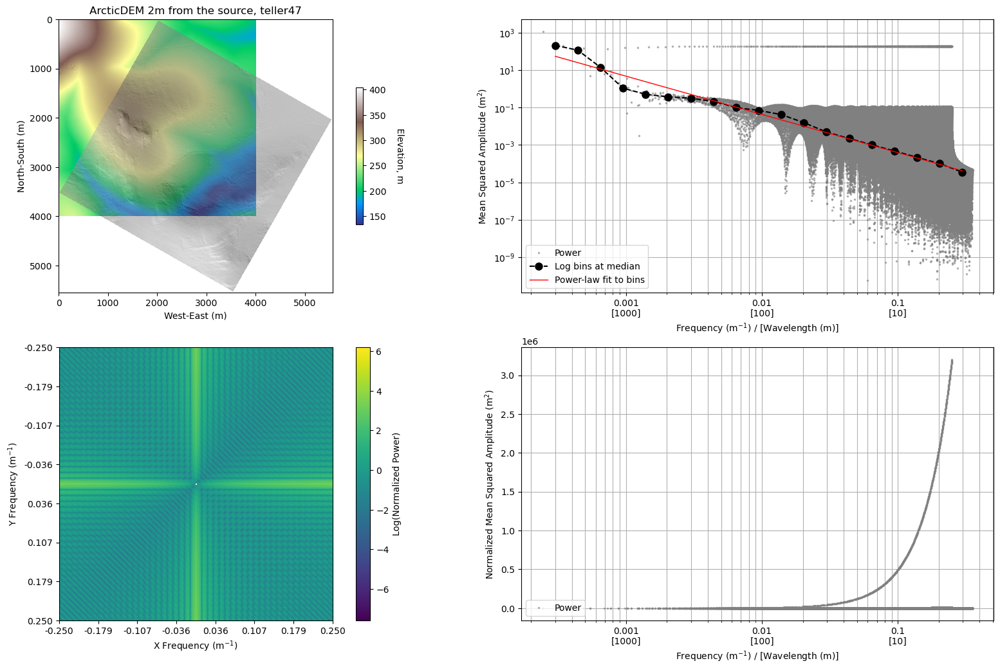

In [243]:
fourier_2d("ArcticDEM 2m from the source, teller47", site_data_dict['t47'], 2, 2, fit_plane=True)

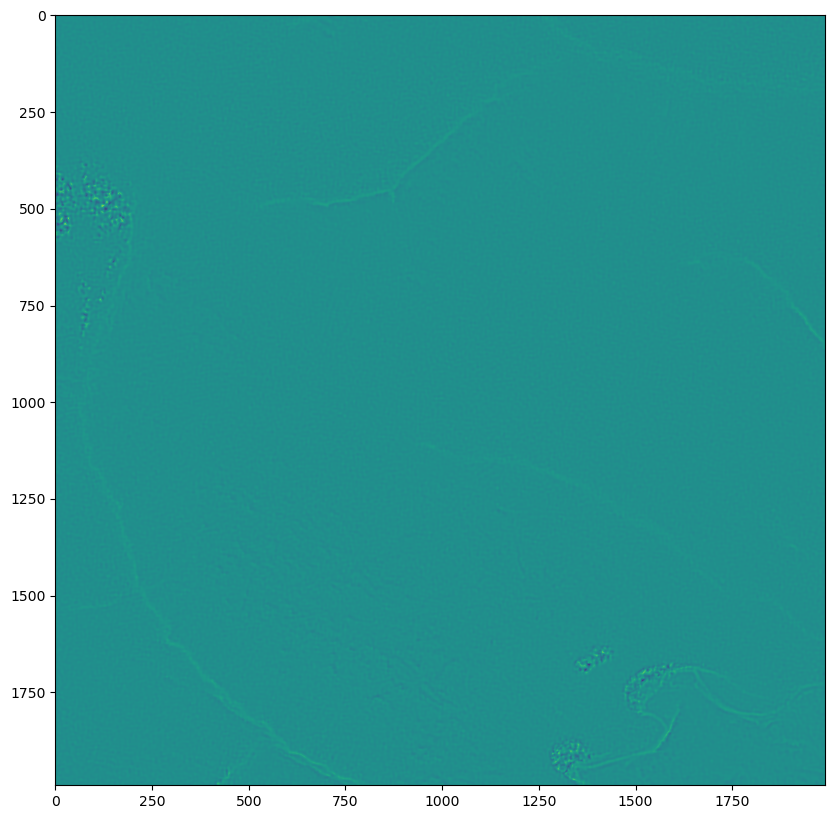

In [245]:
curvature = get_curvature(site_data_dict['t47'], 3)
plt.imshow(curvature[5:-5, 5:-5])

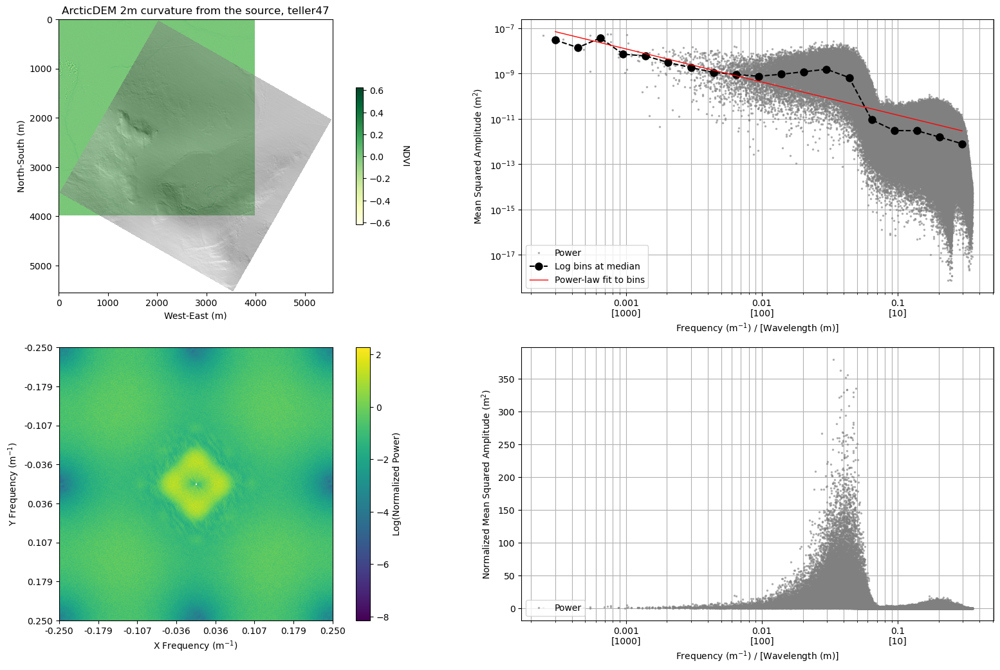

In [246]:
fourier_2d("ArcticDEM 2m curvature from the source, teller47", curvature[5:-5, 5:-5], 2, 2, fit_plane=False)

# Getting data from GEE

In [4]:
try:
    ee.Initialize()
except:
    ee.Authenticate()
    ee.Initialize()

*** Earth Engine *** Share your feedback by taking our Annual Developer Satisfaction Survey: https://google.qualtrics.com/jfe/form/SV_doiqkQG3NJ1t8IS?source=API


In [ ]:
from shapely.geometry import mapping
ee_polygons = []

for i, row in gdf.to_crs('EPSG:4326').iterrows():
    # Extract the geometry from the GeoDataFrame
    geometry = row.geometry

    # Convert the Shapely geometry to GeoJSON format
    geojson_geometry = mapping(geometry)

    # Create an Earth Engine polygon from the GeoJSON geometry
    ee_polygon = ee.Geometry.Polygon(geojson_geometry['coordinates'])

    ee_polygons.append(ee_polygon)



In [22]:
def get_ee_data(roi_square):
    # Define the time range for Sentinel-2 data
    start_date = '2021-06-30'
    end_date = '2021-09-30'

    # Filter Sentinel-2 data
    sentinel2_collection = (ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
                            .filterBounds(roi_square)
                            .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 10))
                            .filterDate(ee.Date(start_date), ee.Date(end_date)))


    # Function to calculate NDVI
    def calculate_ndvi(image):
        ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
        return image.addBands(ndvi)

    # Map the NDVI function over the collection
    sentinel2_with_ndvi = sentinel2_collection.map(calculate_ndvi)
  
    # Load ArcticDEM dataset
    arctic_dem = ee.Image('UMN/PGC/ArcticDEM/V3/2m_mosaic')

    dem_roi = arctic_dem.clip(roi_square)
    hs_roi = ee.Terrain.hillshade(arctic_dem).clip(roi_square)
    
    data_npy = ee.data.computePixels({
        'expression': dem_roi.clip(roi_square),
        'fileFormat': 'NUMPY_NDARRAY'
    })

    hs_npy = ee.data.computePixels({
        'expression': (hs_roi
                    #  .resample('bicubic').reproject(crs=f'EPSG:{epsg}', scale=2)
        .clip(roi_square)),
        'fileFormat': 'NUMPY_NDARRAY'
    })

    ndvi_npy = ee.data.computePixels({
        'expression':sentinel2_with_ndvi.select('NDVI')
        # .reduce(ee.Reducer.mean())
        .first()
        .clip(roi_square),
        'fileFormat': 'NUMPY_NDARRAY'
    })
    elevation = data_npy['elevation']
    elevation = np.ma.masked_where(elevation == 0, elevation)

    hs = hs_npy['hillshade']
    hs = np.ma.masked_where(hs == 0, hs)

    ndvi = ndvi_npy['NDVI']
    ndvi = np.ma.masked_where(ndvi == 0, ndvi)

    return elevation, hs, ndvi

In [249]:
# Define the region of interest (ROI) as a point
# roi_point = ee.Geometry.Point([gdf.loc[gdf['site']=='t47'].long_dd.values[0], gdf.loc[gdf['site']=='t47'].lat_dd.values[0]])  # Adjust the coordinates as needed

# # North Slope
# long = -151.53244
# lat = 68.6287

# Teller 47
# long = -166.236575
# lat = 65.011209

long = gdf.loc[gdf['site']=='t47'].long_dd.values[0]
lat = gdf.loc[gdf['site']=='t47'].lat_dd.values[0]

roi_point = ee.Geometry.Point([long, lat])

# Create a square region around the point with a size of 5 km by 5 km
roi_square = roi_point.buffer(2000).bounds()

In [250]:
# elevation, hs, ndvi = get_ee_data(ee_polygons[0])
elevation, hs, ndvi = get_ee_data(roi_square)

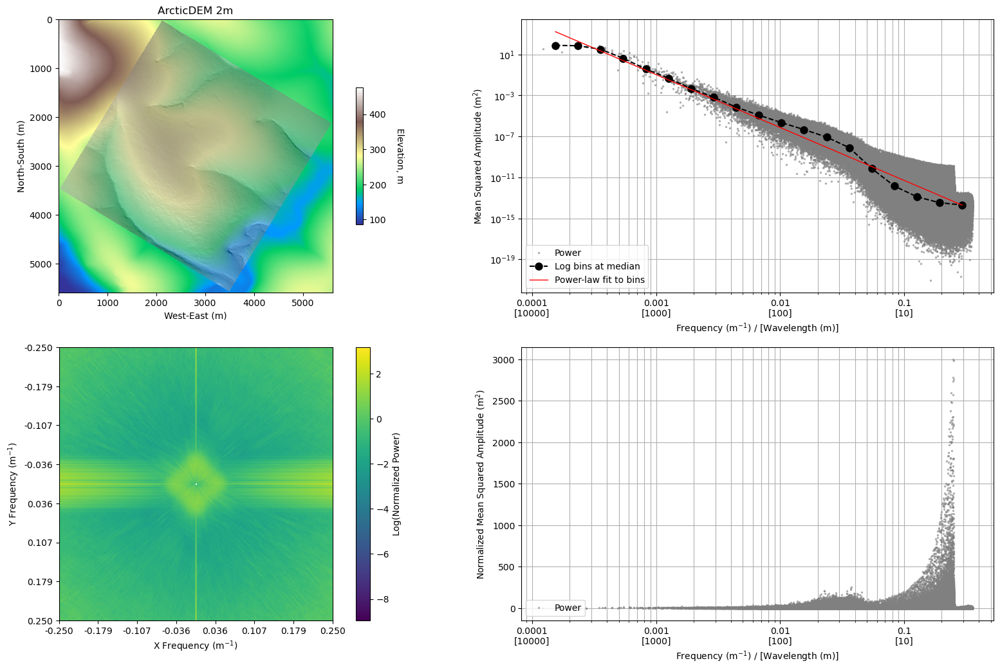

In [251]:
fourier_2d("ArcticDEM 2m", elevation, 2, 2, fit_plane=True, hillshade=True)

In [270]:
1/np.logspace(-2, -1)

array([100.        ,  95.40954763,  91.0298178 ,  86.85113738,
        82.86427729,  79.06043211,  75.43120063,  71.9685673 ,
        68.6648845 ,  65.51285569,  62.50551925,  59.63623317,
        56.89866029,  54.28675439,  51.79474679,  49.41713361,
        47.14866363,  44.98432669,  42.9193426 ,  40.94915062,
        39.06939937,  37.2759372 ,  35.56480306,  33.93221772,
        32.37457543,  30.88843596,  29.47051703,  28.11768698,
        26.82695795,  25.59547923,  24.42053095,  23.29951811,
        22.22996483,  21.20950888,  20.23589648,  19.30697729,
        18.42069969,  17.57510625,  16.76832937,  15.9985872 ,
        15.26417967,  14.56348478,  13.89495494,  13.25711366,
        12.64855217,  12.06792641,  11.51395399,  10.98541142,
        10.48113134,  10.        ])

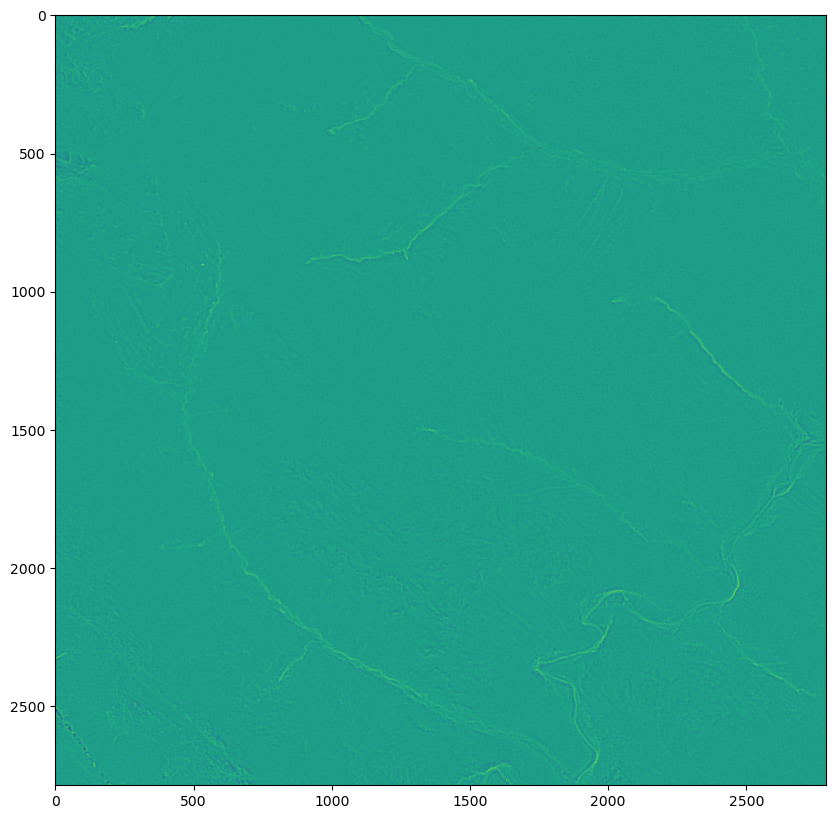

In [252]:
curvature = get_curvature(elevation, 3)
plt.imshow(curvature[5:-5, 5:-5])

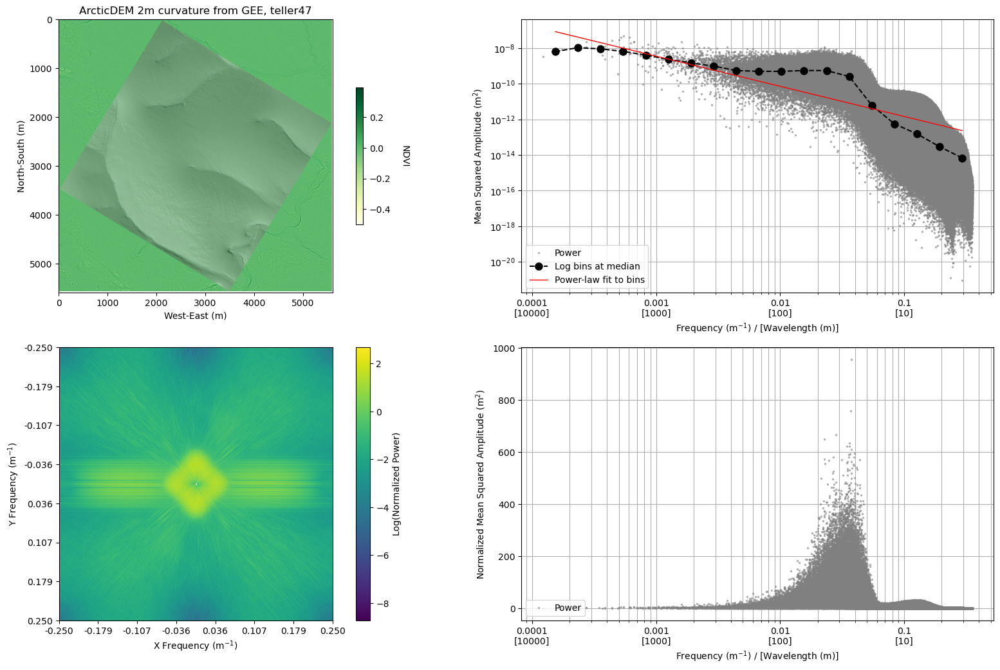

In [253]:
fourier_2d("ArcticDEM 2m curvature from GEE, teller47", curvature[5:-5, 5:-5], 2, 2, fit_plane=False)

## NDVI FT

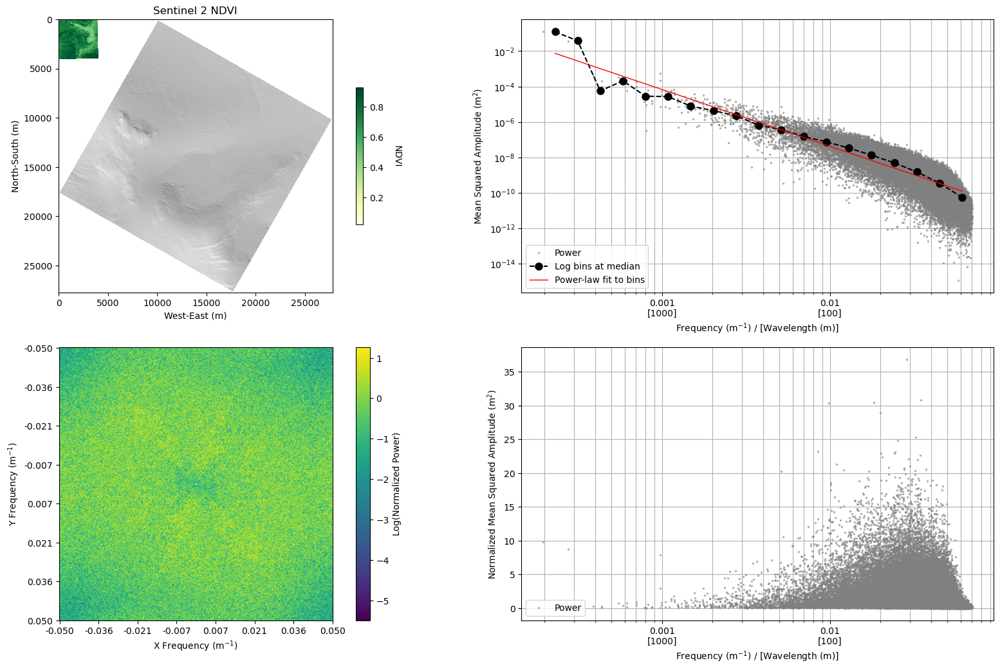

In [33]:
fourier_2d("Sentinel 2 NDVI", ndvi, 10, 2, fit_plane=False)

## Curvature?

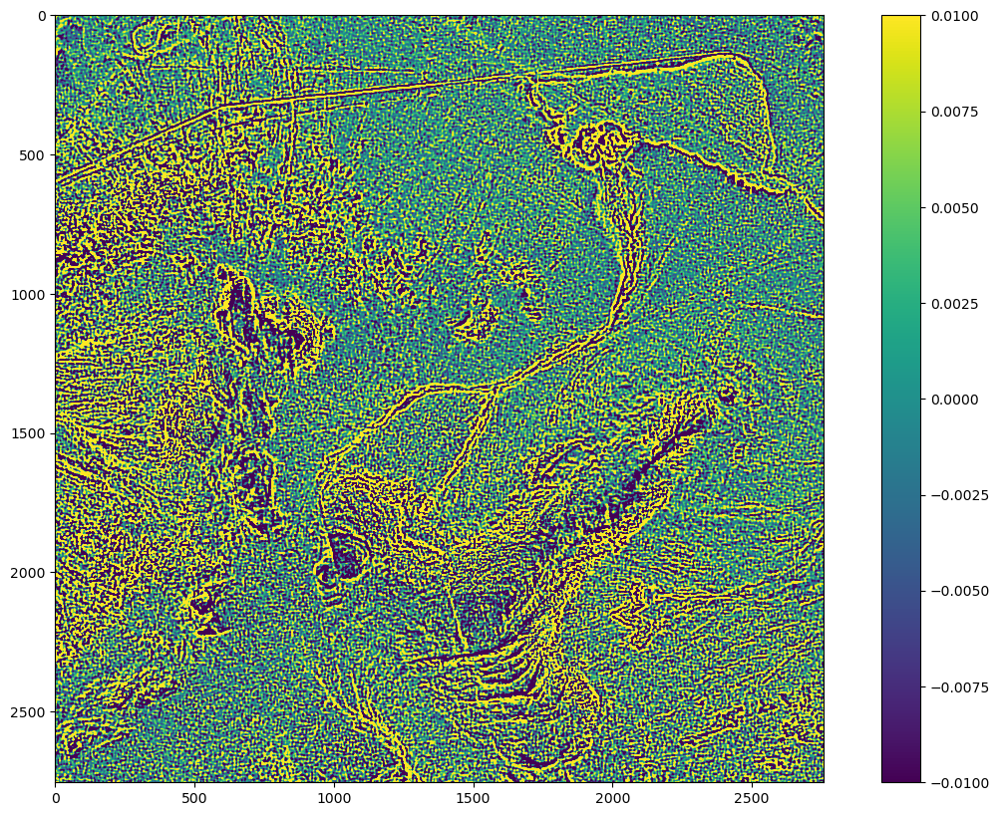

In [34]:
import scipy.signal

# Set the window size
window_size = 50000

# Compute first derivatives with a moving window
dx = scipy.signal.convolve2d(elevation, np.array([[-1, 0, 1]]), mode='same') / 2
dy = scipy.signal.convolve2d(elevation, np.array([[-1], [0], [1]]), mode='same') / 2

# Compute second derivatives with a moving window
dxx = scipy.signal.convolve2d(dx, np.array([[-1, 0, 1]]), mode='same') / 2
dyy = scipy.signal.convolve2d(dy, np.array([[-1], [0], [1]]), mode='same') / 2

# Calculate curvature
curvature = (dxx + dyy) / (1 + dx**2 + dy**2)**1.5

plt.imshow(curvature[10:-10, 10:-10], vmin=-0.01, vmax=0.01)
plt.colorbar()

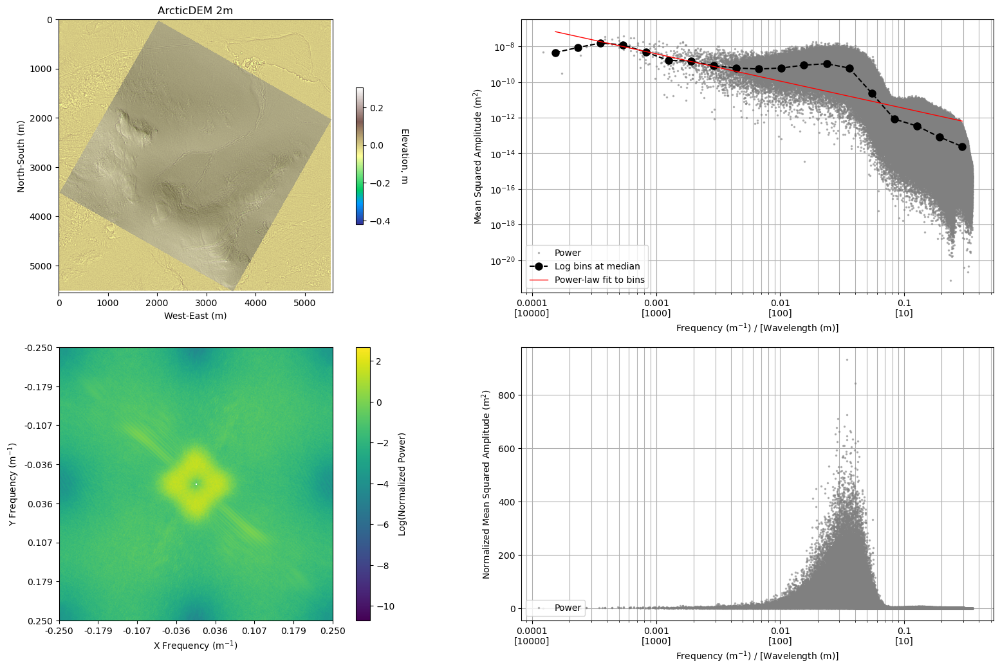

In [35]:
fourier_2d("ArcticDEM 2m", curvature[10:-10, 10:-10], 2, 2, fit_plane=True, hillshade=True)

# Fake data

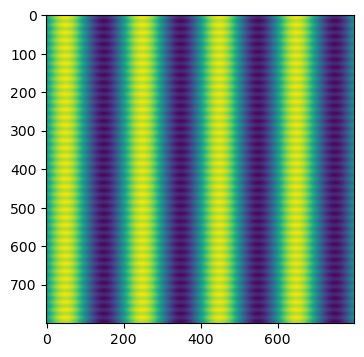

In [215]:
def generate_sine_wave(width, height):
    x = np.arange(width)
    # Generate the first sine wave along the x-axis
    y_x = amplitude_x * np.sin(2 * np.pi * x / wavelength_x) + shift

    # Repeat the first sine wave along the height direction
    sine_wave_x = np.tile(y_x, (height, 1))

    # Generate the second sine wave along the y-axis
    y_y = amplitude_y * np.sin(2 * np.pi * np.arange(height) / wavelength_y) + shift

    # Repeat the second sine wave along the width direction
    sine_wave_y = np.tile(y_y, (width, 1)).T

    # Combine the two sine waves
    combined_sine_waves = sine_wave_x + sine_wave_y

    noise = noise_level * np.random.randn(*combined_sine_waves.shape)

    return combined_sine_waves + noise
    # x = np.arange(width)
    # y = (amplitude * np.sin(2 * np.pi * x / wavelength) + shift) + (amplitude*2 * np.sin(2 * np.pi * x / wavelength/2))

    # # Repeat the sine wave along the height direction
    # image = np.tile(y, (height, 1))

    # noise = 0.4 * np.random.randn(*image.shape)
    # return image + noise

    # return image

# Parameters
width = 800  # Width of the array
height = 800  # Height of the array
wavelength_x = 200  # Wavelength of the sine wave
wavelength_y = 20  # Wavelength of the sine wave
amplitude_x = 20.0  # Amplitude of the sine wave
amplitude_y = 2.0  # Amplitude of the sine wave
shift = 200.0
noise_level = 0.35

# Generate the 2D array with the sine wave
sine_wave_array = generate_sine_wave(width, height)

fig, ax = plt.subplots(figsize=(4,4))
ax.imshow(sine_wave_array)

In [221]:
def run_it(data):
        fn = "fake data"
        z = data
        step = 1
        skip = 1

        # get the size of the raster and save a copy of the original grid
        z_original = z.copy()
        ny, nx = z.shape

        # if fit_plane==True:
        #     # use linear algebra to fit a plane by least squares
        #     x, y = np.meshgrid(range(nx), range(ny))
        #     A = np.vstack([x.ravel(), y.ravel(), np.ones(len(x.ravel()))]).T
        #     fit = np.linalg.lstsq(A, z.ravel(), rcond=None)[0]
        #     z = z - (fit[0]*x + fit[1]*y + fit[2])

        # # apply hanning windowing to reduce spectral leakage on edges
        hann_y = np.hanning(ny)
        hann_x = np.hanning(nx)
        hann_2d = np.sqrt(np.outer(hann_y, hann_x))
        hann_weight = np.sum(hann_2d ** 2)
        # hann_weight = 1.0
        z = z * hann_2d

        # This next step is done to optimize the Cooley and Turkey (1965)
        # Discrete Fourier Transfom (DFT) method used by numpy, which operates
        # most efficiently when the length scales are powers of 2 and the grid
        # is square
        Lx = int(2**(np.ceil(np.log(np.max((nx, ny)))/np.log(2))))
        Ly = Lx

        # run the fft
        fft = np.fft.fftn(z, (Ly, Lx))

        # shift zero frequency to center
        fft_shift = np.fft.fftshift(fft)

        # # index of zero frequency (DC component)
        xc, yc = (Lx//2, Ly//2)

        # # zero out the DC component
        fft_shift[yc, xc] = 0

        # get the DFT periodogram with units of m^2 for topography
        # include weights of hann to correct for windowing
        p2d = np.abs(fft_shift)**2 / (Lx * Ly * hann_weight)

        # The periodogram is a measure of how much of the
        # original elevation field's variance falls within a given frequency range.
        # You can check that the sum of the periodogram is roughly equal to the
        # variance in Z. (The variance will be somewhat less due to the zero padding.)

        # calculate radial frequencies
        # xc, yc = (Lx//2, Ly//2) # (Lx//2 + 1, Ly//2 - 1) # center coordinate
        x, y = np.meshgrid(range(Lx), range(Ly))#[::-1])

        # wavenumbers
        kx = x - xc
        ky = y - yc
        # kx_, ky_ = np.meshgrid(range(-Lx//2, Lx//2 - 1), range(Ly//2, -Ly//2+1, -1))

        # radial frequencies
        fx = kx / (Lx * step)
        fy = ky / (Ly * step)
        f2d = np.sqrt(fx**2 + fy**2)
        # w2d = np.sqrt((1/fx)**2 + (1/fy)**2)
        # f2d = 1/w2d

        # fourier angles
        F_ang2d = np.rad2deg(np.arctan2(ky*step, kx*step))

        # Create sorted, non-redundant vectors of frequency and power
        p1d = p2d[:, 0:xc+1].copy() # only half the power (reflected across the center)
        f1d = f2d[:, 0:xc+1].copy() # same for the frequency
        F_ang1d = F_ang2d[:, 0:xc+1].copy() # same for angle

        # set reundant columns to negative for clipping below
        f1d[yc:Ly, xc] = -1

        # concatenate frequency and power and sort by frequency
        f1d = np.c_[f1d.ravel(), p1d.ravel(), F_ang1d.ravel()]
        I = np.argsort(f1d[:, 0])
        f1d = f1d[I, :]

        # remove negative values
        f1d = f1d[f1d[:, 0] > 0, :]

        # extract power, angle, and frequency (factor of 2 corrects for taking half the spectrum)
        p1d = 2 * f1d[:, 1] # the sum of the p2d and p1d should now be approximately equal
        F_ang1d = f1d[:, 2]
        f1d = f1d[:, 0]

        # bin the data using log bins
        bins = 20
        f_bins = np.logspace(np.log10(f1d.min()), np.log10(f1d.max()), num=bins)
        bin_med, edges, _ = stats.binned_statistic(f1d, p1d, statistic=np.nanmedian,
                                        bins=f_bins)
        bin_center = edges[:-1] + np.diff(edges)/2

        # sometimes NaN values remain in some bins, throw those bins out
        bin_center = bin_center[np.isfinite(bin_med)]
        bin_med = bin_med[np.isfinite(bin_med)]

        # apply a power-law fit to the bins
        A = np.vstack([np.log10(bin_center), np.ones(len(bin_center))]).T
        fit = np.linalg.lstsq(A, np.log10(bin_med), rcond=None)[0]
        pl_fit = (10**fit[1]) * (bin_center**fit[0])

        # use the power-law fit to normalize the 1D spectrum
        p1d_norm = p1d / ((10**fit[1]) * (f1d**fit[0]))

        # use the power-law fit to normalize the 2D spectrum
        p2d_norm = p2d / ((10**fit[1]) * (f2d**fit[0]))

        # make a figure
        fig, axes = plt.subplots(2, 2, figsize=(19, 11),
                                gridspec_kw={'left':0.1, 'right':0.95,
                                                'bottom':0.1, 'top':0.95})
        ax1, ax2, ax3, ax4 = axes[0, 1], axes[1, 1], axes[0, 0], axes[1, 0]

        # first plot the original 1D power specturm
        ax1.loglog(f1d[::skip], p1d[::skip], '.', c='gray', alpha=0.5, markersize=3, label="Power",
                rasterized=True)
        ax1.loglog(bin_center, bin_med, 'ko--', markersize=8, alpha=1,
                label="Log bins at median")
        ax1.loglog(bin_center, pl_fit, 'r-', lw=1, label="Power-law fit to bins")
        ax1.set_xticklabels(["{:}\n[{:.0f}]".format(a, 1/a) for a in ax1.get_xticks()])
        ax1.set_xlabel('Frequency (m$^{-1}$) / [Wavelength (m)]')
        ax1.set_ylabel('Mean Squared Amplitude (m$^2$)')
        ax1.grid(True, which="both")
        ax1.legend(loc='lower left', fontsize=10)

        # then plot the normalized 1D power specturm
        ax2.semilogx(f1d[::skip], p1d_norm[::skip], '.', c='gray', alpha=0.5, markersize=3, label="Power",
                rasterized=True)
        #     ax2.set_ylim(0, p1d_norm.max())
        ax2.set_xticklabels(["{:}\n[{:.0f}]".format(a, 1/a) for a in ax2.get_xticks()])
        ax2.set_xlabel('Frequency (m$^{-1}$) / [Wavelength (m)]')
        ax2.set_ylabel('Normalized Mean Squared Amplitude (m$^2$)')
        ax2.grid(True, which="both")
        ax2.legend(loc='lower left', fontsize=10)

        # now plot the original DEM

        im = ax3.imshow(z_original, cmap='terrain')
        cbar = plt.colorbar(im, ax=ax3, shrink=0.5)
        cbar.set_label('Elevation, m', rotation=270, labelpad=20)


        # ax3.imshow(hs, cmap='Greys', alpha=0.5)
        # these next lines add some labels
        ax3.set_xticklabels(["{:.0f}".format(x * step) for x in ax3.get_xticks()])
        ax3.set_yticklabels(["{:.0f}".format(y * step) for y in ax3.get_yticks()])
        ax3.set_xlabel("West-East (m)")
        ax3.set_ylabel("North-South (m)")
        ax3.set_title(fn)

        # also plot the normalized 2D power spectrum
        im = ax4.imshow(np.log10(p2d_norm))
        fig.colorbar(im, ax=ax4, label="Log(Normalized Power)")
        ax4.set_xlabel("X Frequency (m$^{-1}$)")
        ax4.set_ylabel("Y Frequency (m$^{-1}$)")
        nfy, nfx = f2d.shape
        nyq = f2d[nfy//2 + 1, 0]
        n_labels = 8
        ax4.set_xticks(np.linspace(1, nfx, n_labels))
        ax4.set_yticks(np.linspace(1, nfy, n_labels))
        ticks = ["{:.3f}".format(a) for a in np.linspace(-nyq, nyq, n_labels)]
        ax4.set_xticklabels(ticks)
        ax4.set_yticklabels(ticks)

        plt.show()

        # return p2d_norm

You need like 8 wavelengths within the window to overcome the noise

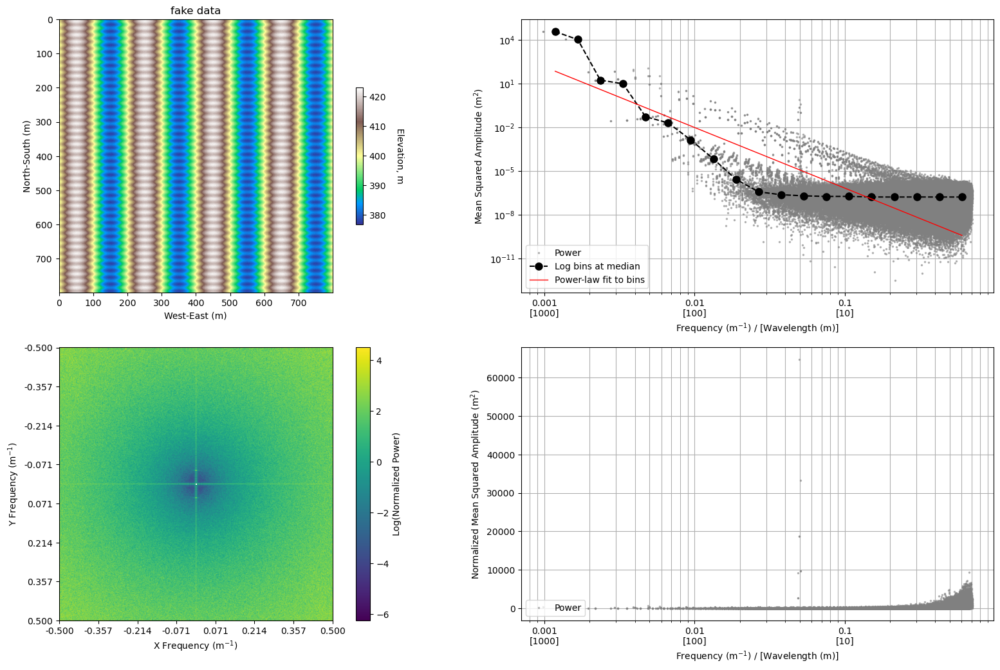

In [222]:
run_it(sine_wave_array)

In [226]:
def get_curvature(data, window_size):
    # Set the window size
    # window_size = 100

    # Compute first derivatives with a moving window
    dx = scipy.signal.convolve2d(data, np.array([[-1, 0, 1]]), mode='same') / 2
    dy = scipy.signal.convolve2d(data, np.array([[-1], [0], [1]]), mode='same') / 2

    # Compute second derivatives with a moving window
    dxx = scipy.signal.convolve2d(dx, np.array([[-1, 0, 1]]), mode='same') / 2
    dyy = scipy.signal.convolve2d(dy, np.array([[-1], [0], [1]]), mode='same') / 2

    # Calculate curvature
    curvature = (dxx + dyy) / (1 + dx**2 + dy**2)**1.5

    return curvature


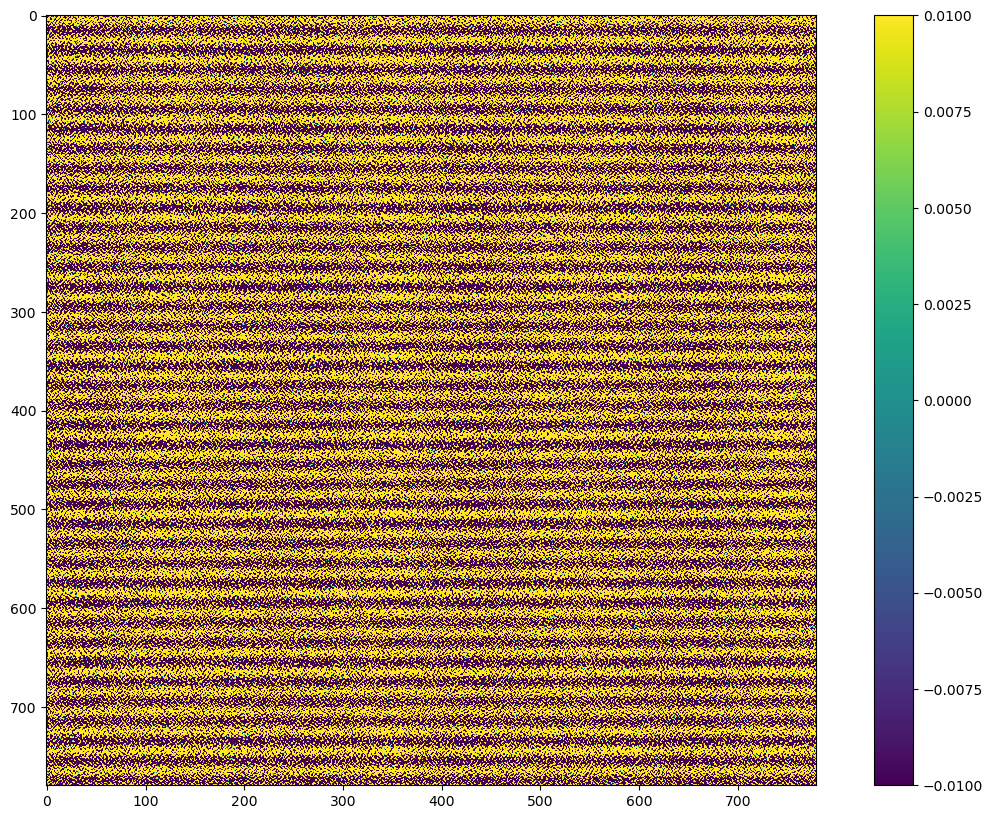

In [227]:
# # Set the window size
# window_size = 100

# # Compute first derivatives with a moving window
# dx = scipy.signal.convolve2d(sine_wave_array, np.array([[-1, 0, 1]]), mode='same') / 2
# dy = scipy.signal.convolve2d(sine_wave_array, np.array([[-1], [0], [1]]), mode='same') / 2

# # Compute second derivatives with a moving window
# dxx = scipy.signal.convolve2d(dx, np.array([[-1, 0, 1]]), mode='same') / 2
# dyy = scipy.signal.convolve2d(dy, np.array([[-1], [0], [1]]), mode='same') / 2

# # Calculate curvature
# curvature = (dxx + dyy) / (1 + dx**2 + dy**2)**1.5
curvature = get_curvature(sine_wave_array, 100)
plt.imshow(curvature[10:-10, 10:-10], vmin=-0.01, vmax=0.01)
plt.colorbar()

In [224]:
print(f'X frequency: {1/wavelength_x}; Y frequency: {1/wavelength_y}')

X frequency: 0.005; Y frequency: 0.05


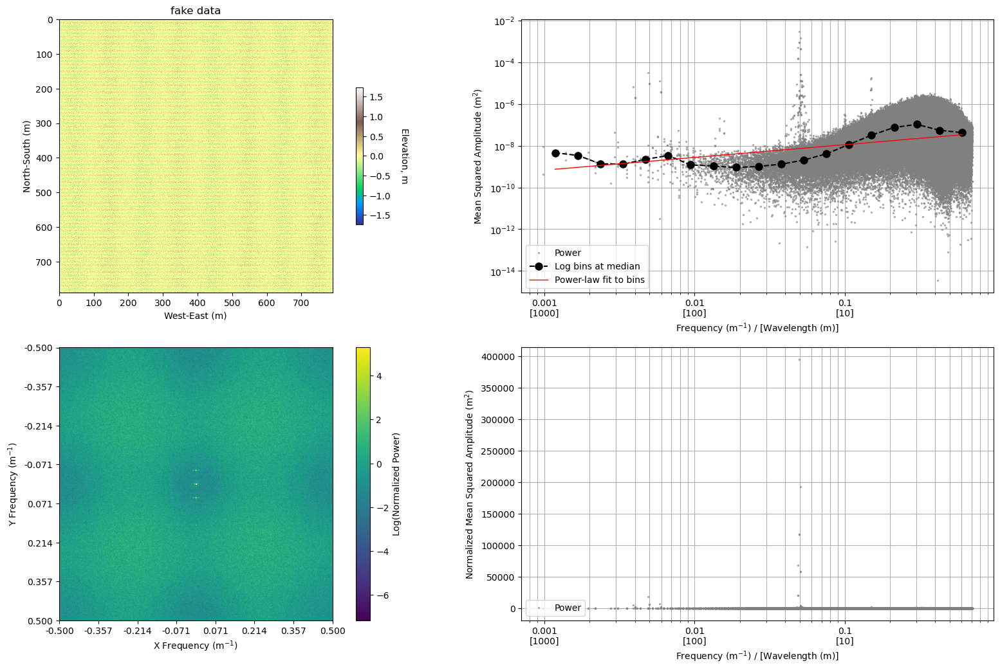

In [225]:
run_it(curvature[5:-5, 5:-5])

In [137]:
f1d[np.argmax(p1d_norm)]

0.0712890625

In [131]:
1/(f1d)[np.argmax(p1d_norm)]

14.027397260273972

# Perform 2DFT on lidar

In [228]:
fname = gdf['file'].to_list()[0]
with rasterio.open(f'data/{fname}') as src:

    geometry = gdf.to_crs(src.crs).geometry.to_list()[0]
    
    # Crop the GeoTIFF using the shapefile geometry
    cropped, _ = mask(src, [mapping(geometry)], crop=True)

    # Get the metadata of the original GeoTIFF
    meta = src.meta.copy()

    # Update metadata with the new dimensions and transform
    # meta.update({
    #     'height': cropped.shape[1],
    #     'width': cropped.shape[2],
    #     'transform': rasterio.windows.transform(window=src.window(*geometry.bounds))
    # })

    # Read the cropped area as a NumPy array
    cropped_array = cropped[0, :, :]
    cropped_array = np.ma.masked_where(cropped_array < 0, cropped_array)

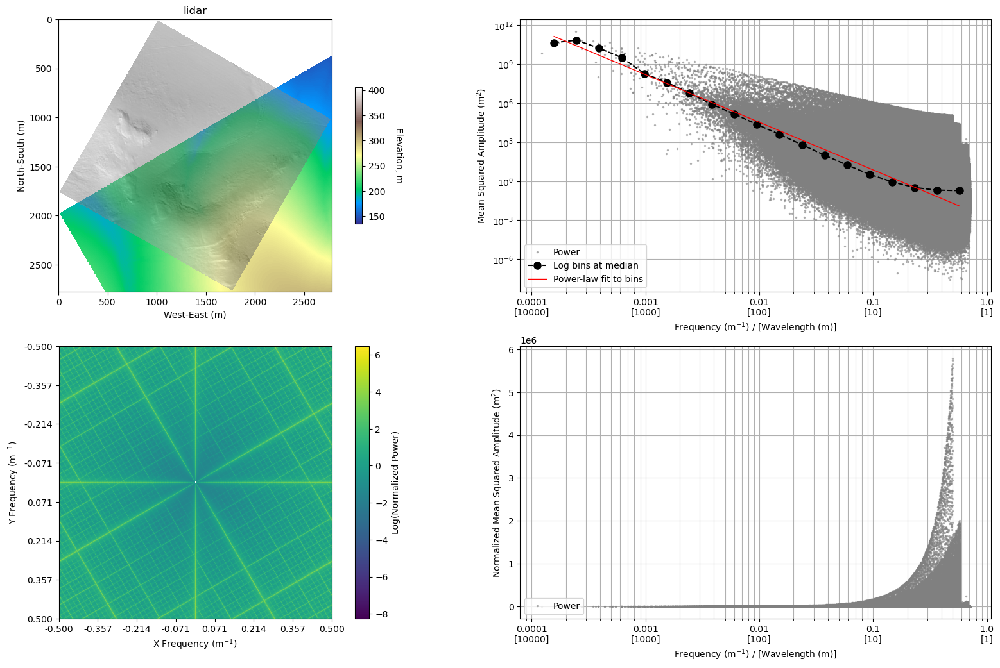

In [229]:
fourier_2d("lidar", cropped_array, 1, 2, fit_plane=True)

In [231]:
cropped_array_inset = cropped_array[2000:-2000, 2000:-2000]
# plt.imshow(cropped_array_inset)

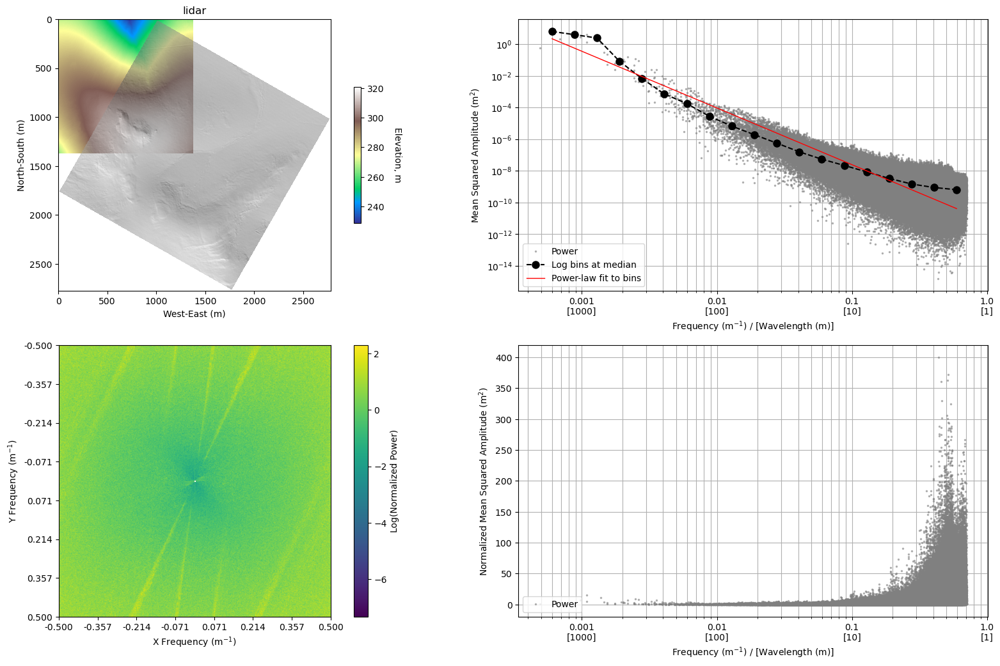

In [233]:
# fourier_2d("lidar", cropped_array, 1, 2, fit_plane=True)
fourier_2d("lidar", cropped_array_inset, 1, 2, fit_plane=True)

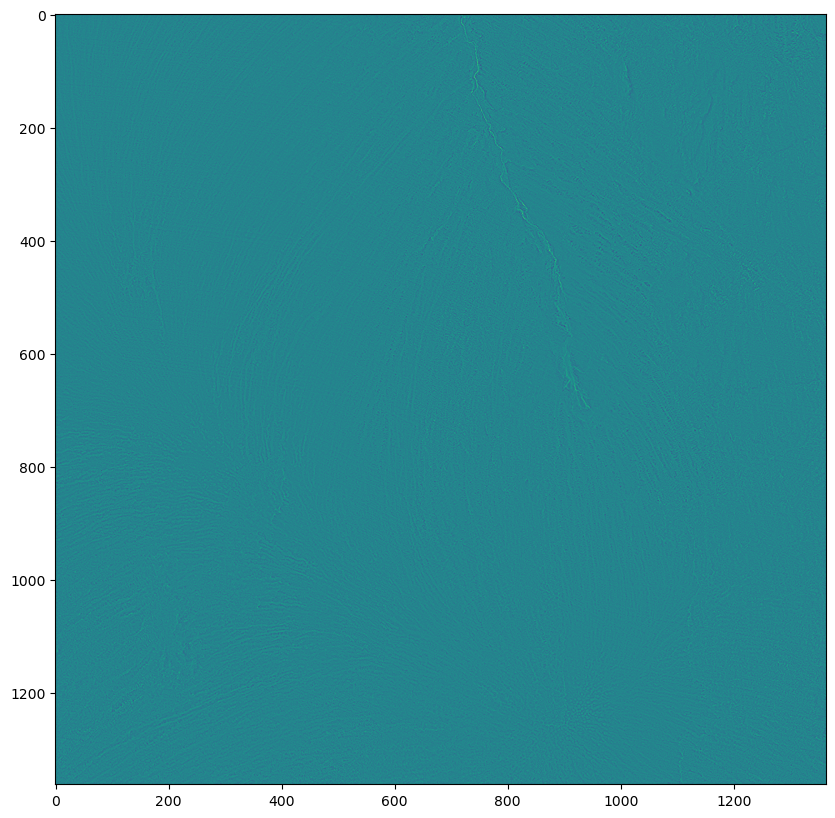

In [239]:
curvature = get_curvature(cropped_array_inset, 3)
plt.imshow(curvature[5:-5, 5:-5])

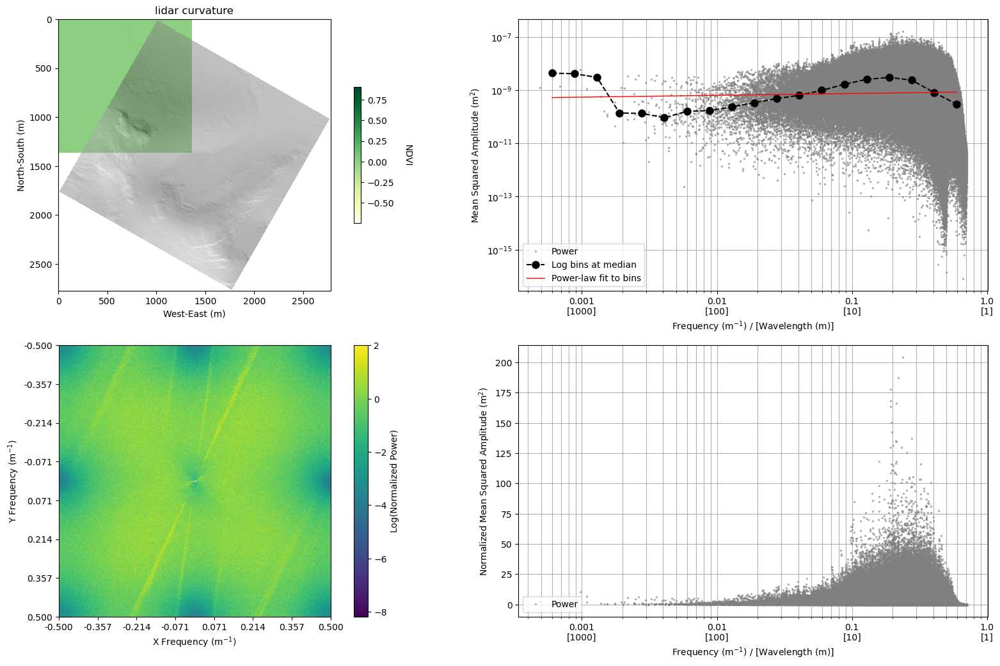

In [240]:
fourier_2d("lidar curvature", curvature[5:-5, 5:-5], 1, 2, fit_plane=False)

# Things that aren't water tracks

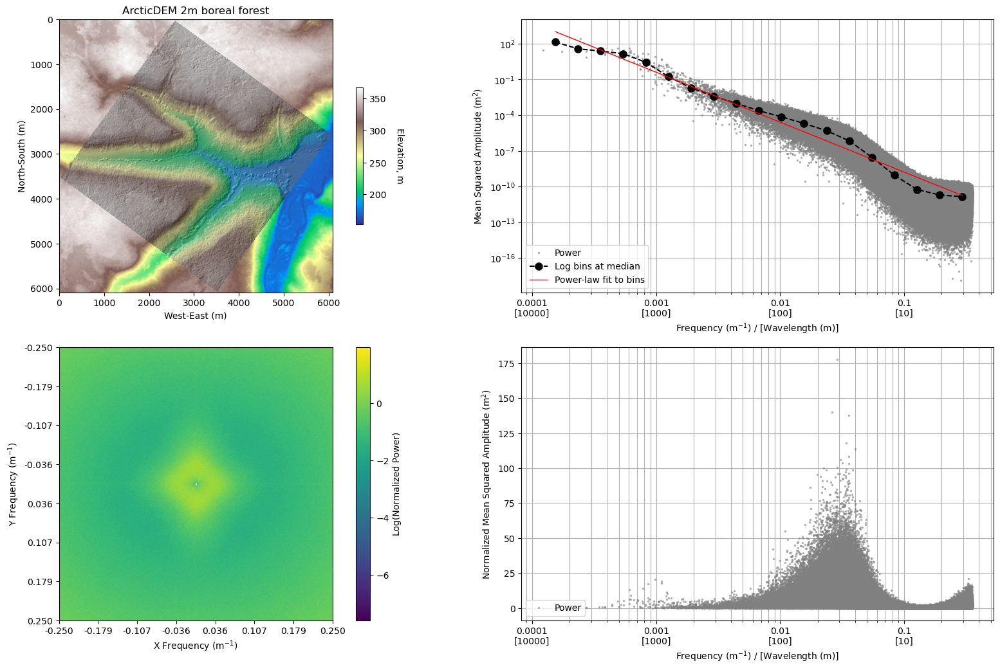

In [410]:
lat = 60.442720
long = 98.864660

# lat = 68.07147984358716
# long = -150.72790055720904

roi_point = ee.Geometry.Point([long, lat])

# Create a square region around the point with a size of 5 km by 5 km
# roi_square = roi_point.buffer(2100).bounds()

roi_square = roi_point.buffer(2100).bounds()

elevation, hs, ndvi = get_ee_data(roi_square)

fourier_2d("ArcticDEM 2m boreal forest", elevation, 2, 2, fit_plane=True, hillshade=True)


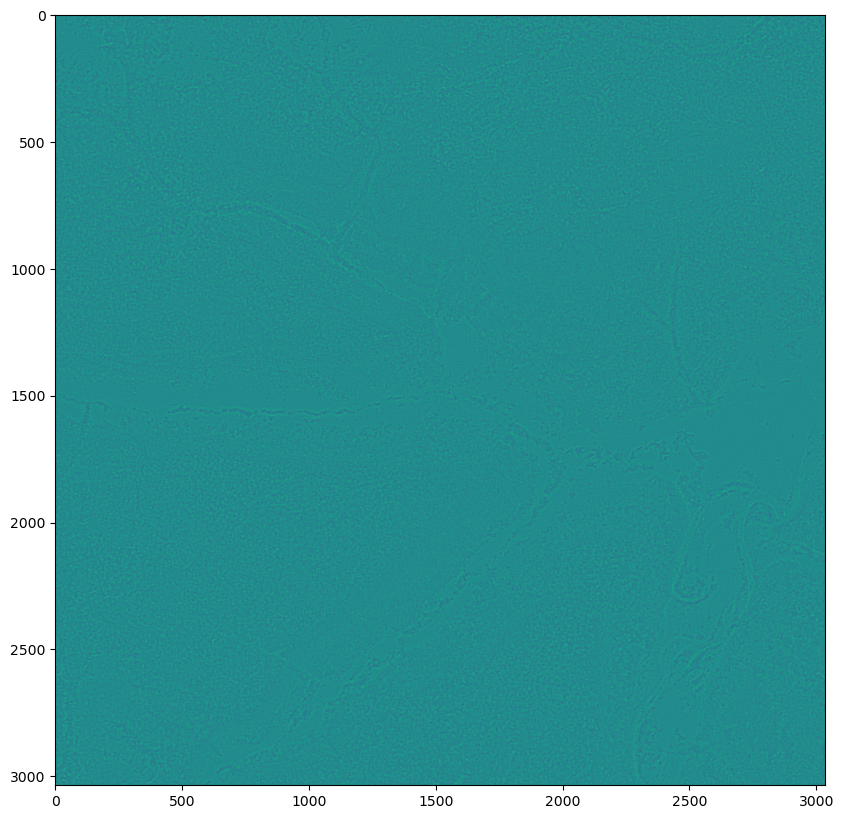

In [411]:
curvature = get_curvature(elevation, 100)
plt.imshow(curvature[5:-5, 5:-5])

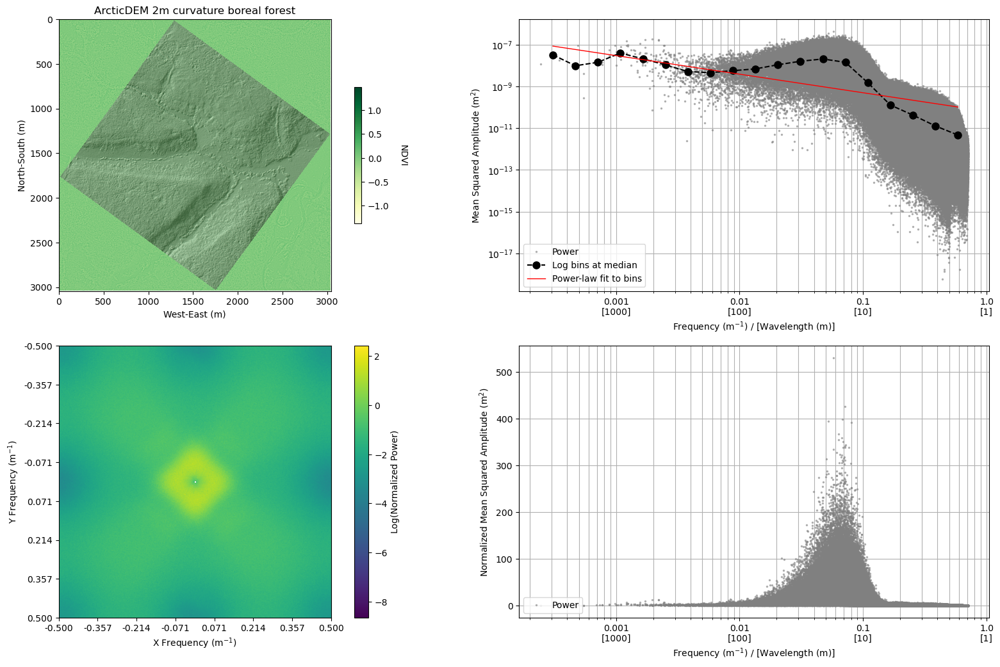

In [412]:
fourier_2d("ArcticDEM 2m curvature boreal forest", curvature[5:-5, 5:-5], 1, 2, fit_plane=False)

In [363]:
lat = 60.442720
long = 98.864660
center_point = Point(long, lat)
gdf = gpd.GeoDataFrame({'geometry': [center_point]}, crs='EPSG:4326').to_crs('EPSG:3413')
xmin, ymin, xmax, ymax = gdf.buffer(2500, cap_style=3).bounds.values[0]

In [364]:
corner_points = gpd.GeoDataFrame(geometry=[
    Point(xmin, ymin),  # Lower-left corner
    Point(xmax, ymin),  # Lower-right corner
    Point(xmax, ymax),  # Upper-right corner
    Point(xmin, ymax)   # Upper-left corner
], crs='EPSG:3413').to_crs('EPSG:4326')

In [380]:
corner_points['index'] = corner_points.index
# corner_points.to_crs('EPSG:3413').explore()

corner_points['buffer_geo'] = corner_points.to_crs('EPSG:3413').buffer(2500, cap_style=3)

ee_shapes = corner_points.set_geometry(corner_points['buffer_geo'], crs='EPSG:3413').to_crs('EPSG:4326')

ee_polygons_list = []

for index, row in ee_shapes.iterrows():
    polygon_coords = list(row['geometry'].exterior.coords)
    ee_polygon = ee.Geometry.Polygon(polygon_coords)
    ee_polygons_list.append(ee_polygon)

In [382]:
elevation_list = []
# pt_list = zip(corner_points.geometry.x.values, corner_points.geometry.y.values)
for roi in ee_polygons_list:

    elevation, hs, ndvi = get_ee_data(roi)

    elevation_list.append(elevation)

In [393]:
np.shape(vs1)

(5002, 2501)

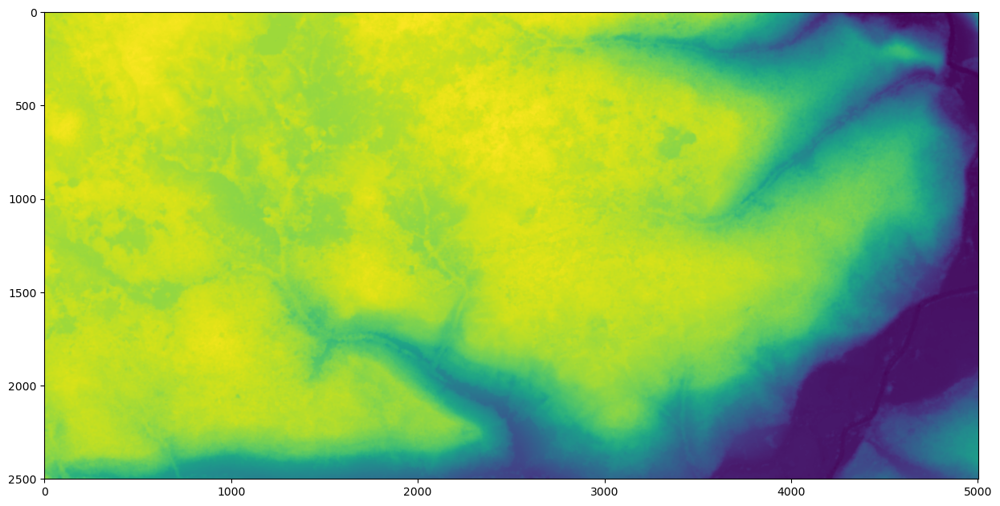

In [399]:
plt.imshow(np.hstack(([elevation_list[3], elevation_list[2]])))

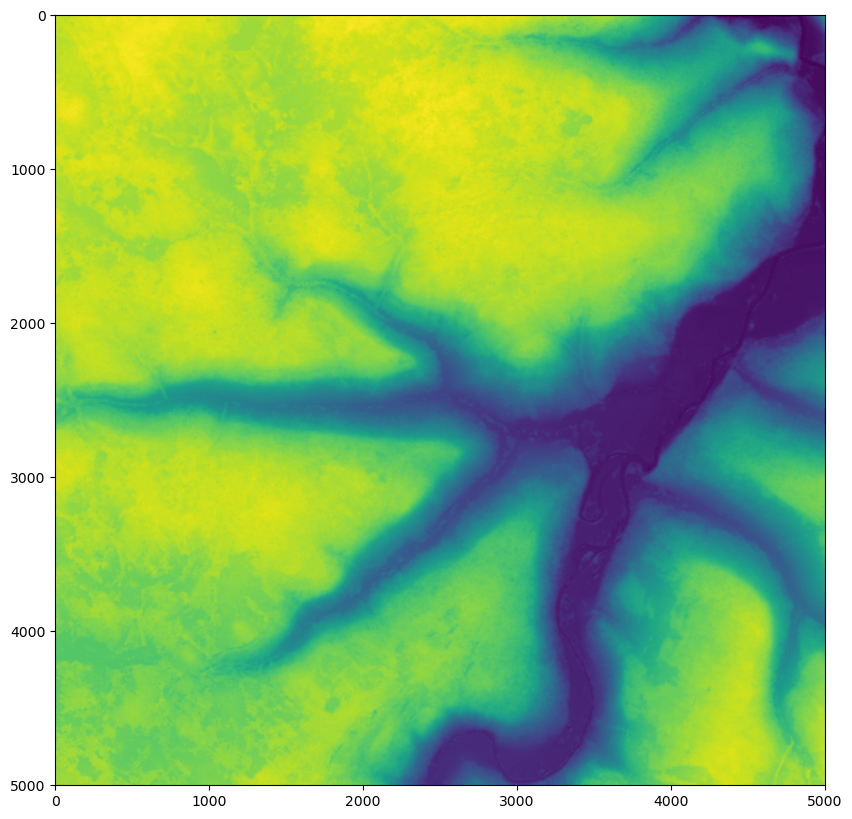

In [400]:
vs1 = np.hstack([elevation_list[0], elevation_list[1]])
vs2 = np.hstack([elevation_list[3], elevation_list[2]])
stacked = np.vstack([vs2, vs1])
plt.imshow(stacked)

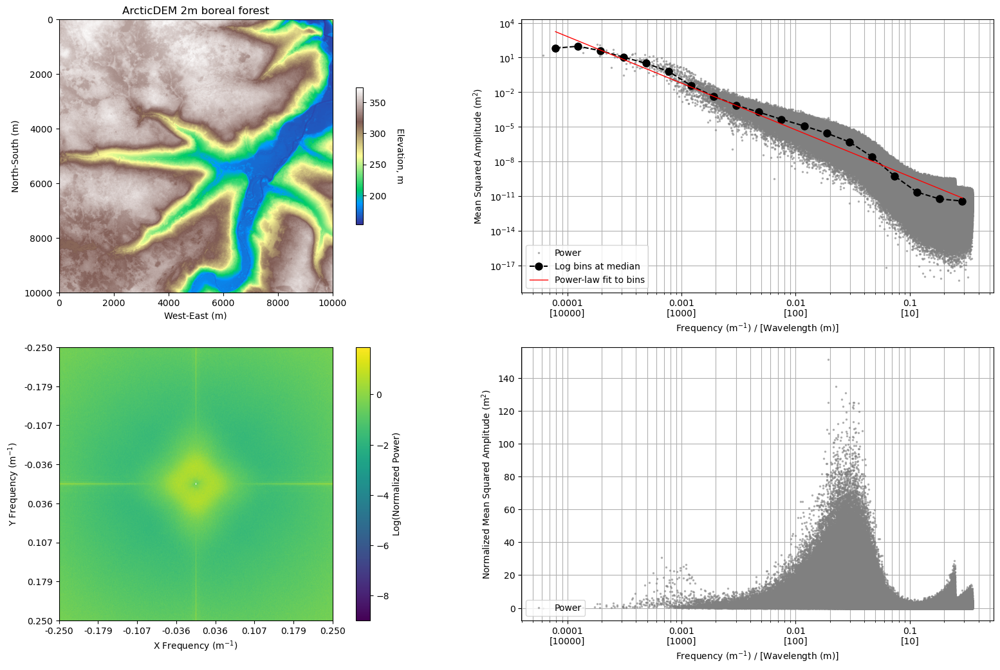

In [401]:
fourier_2d("ArcticDEM 2m boreal forest", stacked, 2, 2, fit_plane=True, hillshade=False)